<a href="https://colab.research.google.com/github/EndarMuh/PCVK_Ganjil_2023/blob/main/UAS_PCVK_KELOMPOK_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **UAS PCVK TI - 3F**

Dosen Pengampu : Septian Enggar Sukmana, S.Pd., M.T

Kelompok 4 :
1. Ahmad Bima Tristan Ibrahim (01/2141720055)
2. Arsyanda Irza Rabbani Yuardhino (6/2141720245)
3. Muhammad Endar Darmawan (21/2141720160)

Link Gdrive : https://drive.google.com/drive/folders/1C08KMZYNBa2RpsNLdCx3SIYfjuCOY_Uj?usp=sharing

Link Github : https://github.com/EndarMuh/PCVK_Ganjil_2023/blob/main/UAS_PCVK_KELOMPOK_4.ipynb

Link Collab : https://colab.research.google.com/drive/1h_FOv7Yx5C286e-4X5b_-lnVfxlJQsWd?usp=sharing

### **Sambungkan dengan Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### **Import Library yang dibutuhkan**

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import zipfile
import re
import cv2
import random
import os
from PIL import Image
import subprocess
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model

CNN MODEL

In [ ]:
from tensorflow.keras.datasets import mnist

In [ ]:
(train_data, train_labels), (test_data, test_labels) = mnist.load_data()

11490434/11490434 [==============================] - 0s 0us/step


Penjelasan Kode : Kode tersebut digunakan untuk memuat dataset MNIST yang populer untuk pelatihan model machine learning dan deep learning.

In [ ]:
(train_data.shape, test_data.shape)

((60000, 28, 28), (10000, 28, 28))

Penjelasan Kode : Kode tersebut digunakan untuk memeriksa bentuk data dari dataset MNIST yang telah dimuat sebelumnya. Bentuk data adalah deskripsi dimensi dari sebuah array NumPy.

In [ ]:
(train_labels.shape, test_labels.shape)

((60000,), (10000,))

Penjelasan Kode : Kode tersebut digunakan untuk memeriksa bentuk dari label-label data MNIST yang telah dimuat sebelumnya.

In [ ]:
train_data[0].shape

(28, 28)

Penjelasan Kode : Kode tersebut memeriksa bentuk dari satu contoh gambar dalam dataset MNIST yang baru saja dimuat. Secara spesifik, kode ini mengakses elemen 0 dari array train_data, ini berarti kita mengambil gambar pertama dalam set pelatihan dan menggunakan atribut .shape pada gambar yang diambil untuk mengakses bentuk atau dimensi dari gambar tersebut.

In [ ]:
train_labels.shape

(60000,)

Penjelasan Kode : Kode tersebut digunakan untuk memeriksa bentuk data dari label-label dataset MNIST yang telah dimuat sebelumnya.

combine train and test

In [ ]:
digits_data = np.vstack([train_data, test_data])
digits_labels = np.hstack([train_labels, test_labels])

Penjelasan Kode : Kode tersebut digunakan untuk menggabungkan set pelatihan dan set pengujian dari dataset MNIST menjadi array NumPy tunggal untuk kedua data dan label.

In [ ]:
digits_data.shape

(70000, 28, 28)

Penjelasan Kode : Kode *digits_data.shape* digunakan untuk memeriksa bentuk dari array NumPy digits_data yang telah digabungkan dari set pelatihan dan pengujian dataset MNIST.

In [ ]:
digits_labels.shape

(70000,)

Penjelasan Kode : Kode *digits_labels.shape* digunakan untuk memeriksa bentuk dari array NumPy digits_labels yang telah digabungkan dari label set pelatihan dan pengujian dataset MNIST.

Text(0.5, 1.0, 'Class: 5')

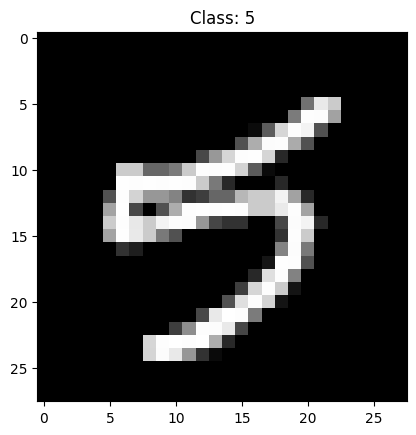

In [ ]:
idx = np.random.randint(0, digits_data.shape[0])
plt.imshow(digits_data[idx], cmap='gray')
plt.title('Class: ' + str(digits_labels[idx]))

Penjelasan Kode : Kode ini untuk memvisualisasikan gambar dan labelnya secara acak dari dataset MNIST. Ini berguna untuk memeriksa secara acak apakah data dan label sesuai dan bahwa penggabungan data berhasil.

In [ ]:
df_labels = pd.DataFrame(digits_labels, columns=['Labels'])
# sns.countplot(df_labels, x='Labels')

Penjelasan Kode : Kode tersebut digunakan untuk memvisualisasikan distribusi data dalam bentuk histogram atau count plot.

load kaggle

In [ ]:
!wget https://iaexpert.academy/arquivos/alfabeto_A-Z.zip

--2023-12-21 13:21:21--  https://iaexpert.academy/arquivos/alfabeto_A-Z.zip
Resolving iaexpert.academy (iaexpert.academy)... 162.159.134.42
Connecting to iaexpert.academy (iaexpert.academy)|162.159.134.42|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 193643888 (185M) [application/zip]
Saving to: ‘alfabeto_A-Z.zip’

alfabeto_A-Z.zip    100%[===================>] 184.67M  89.5MB/s    in 2.1s    

2023-12-21 13:21:23 (89.5 MB/s) - ‘alfabeto_A-Z.zip’ saved [193643888/193643888]



Penjelasan Kode : Kode tersebut adalah perintah shell untuk mengunduh (download) file dari internet menggunakan perintah wget. Kode tersebut mengarahkan wget untuk mengunduh file dengan URL yang diberikan.

In [ ]:
zip_object = zipfile.ZipFile(file = 'alfabeto_A-Z.zip', mode = 'r')
zip_object.extractall('./')
zip_object.close()

Penjelasan Kode : Kode tersebut merupakan potongan kode Python yang bertujuan untuk mengekstrak (extract) isi dari file zip. Dengan menjalankan kode ini, isi dari file zip 'alfabeto_A-Z.zip' akan diekstrak ke dalam direktori saat ini. Sehingga, jika dalam file zip tersebut terdapat file atau folder, maka mereka akan ditempatkan di direktori yang sama dengan file zip setelah proses ekstraksi selesai.

In [ ]:
dataset_az = pd.read_csv('A_Z Handwritten Data.csv').astype('float32')
dataset_az

,0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,...,0.639,0.640,0.641,0.642,0.643,0.644,0.645,0.646,0.647,0.648
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372445,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372446,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372447,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372448,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Penjelasan Kode : Kode tersebut digunakan untuk membaca dataset dari file CSV dan mengonversi tipe data kolom-kolomnya menjadi float32. Dataset tersebut kemudian ditampilkan atau dicetak untuk memeriksa struktur dan isinya.

In [ ]:
# Get pixel data only
alphabet_data = dataset_az.drop('0', axis=1)
# Get labels only
alphabet_labels = dataset_az['0']

Penjelasan Kode : Kode tersebut bertujuan untuk memisahkan dataset huruf menjadi dua bagian, satu berisi data piksel (pixel data) dari gambar huruf, dan yang lainnya berisi label atau kategori yang menunjukkan huruf apa yang direpresentasikan oleh setiap data piksel.

In [ ]:
# Check shape data
alphabet_data.shape, alphabet_labels.shape

((372450, 784), (372450,))

Penjelasa Kode : Kode tersebut bertujuan untuk memeriksa bentuk atau dimensi dari alphabet_data dan alphabet_labels.

In [ ]:
# Check shape labels
alphabet_labels.shape

(372450,)

Kode tersebut memiliki tujuan yang sama dengan kode sebelumnya, yaitu untuk memeriksa bentuk atau dimensi dari alphabet_labels. Jadi, dengan menjalankan baris kode tersebut, kita dapat melihat jumlah label atau kategori dalam dataset huruf, yang seharusnya sesuai dengan jumlah sampel atau data piksel dalam dataset yang sesuai.

In [ ]:
# Reshape pixel data to 28*28
alphabet_data = np.reshape(alphabet_data.values, (alphabet_data.shape[0], 28, 28))
# Check the result by its shape
alphabet_data.shape

(372450, 28, 28)

Penjelasan Kode : Kode tersebut memiliki tujuan untuk mengubah bentuk atau reshaping data piksel dalam alphabet_data agar sesuai dengan dimensi yang umum digunakan untuk representasi gambar, yaitu 28x28 piksel.

Text(0.5, 1.0, 'Class: 19.0')

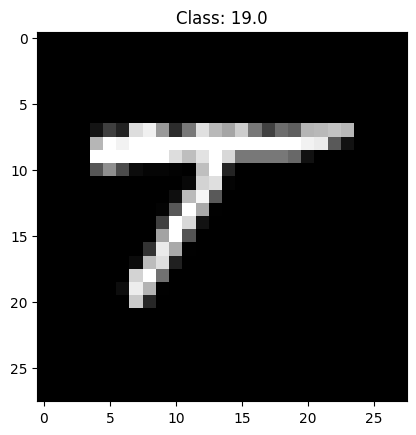

In [ ]:
# Randomly checking A-Z dataset
index = np.random.randint(0, alphabet_data.shape[0])
plt.imshow(alphabet_data[index], cmap = 'gray')
plt.title('Class: ' + str(alphabet_labels[index]))

Penjelasa Kode : Kode tersebut memiliki tujuan untuk secara acak memilih satu sampel dari dataset huruf (A-Z), menampilkannya sebagai gambar menggunakan Matplotlib, dan menunjukkan label atau kelas yang sesuai.

In [ ]:
# Check data distribution
df_az_labels = pd.DataFrame({
    'Labels': alphabet_labels.values
})
# sns.countplot(df_az_labels, x='Labels')

Penjelasan Kode : Kode ini bertujuan untuk memvisualisasikan distribusi kelas atau label pada dataset huruf (A-Z) setelah proses pembacaan dan pengolahan data.

combine mnist and kaggle

In [ ]:
# Check unique value from digits_labels
np.unique(digits_labels)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8)

Penjelasan Kode : Kode tersebut bertujuan untuk mengecek nilai unik atau kelas yang ada dalam array digits_labels. Dengan menjalankan baris kode tersebut, kita dapat melihat nilai-nilai unik atau kelas yang terdapat dalam array digits_labels.

In [ ]:
# Check unique value from alphabet_labels
np.unique(alphabet_labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.],
      dtype=float32)

Penjelasan Kode : Kode tersebut bertujuan untuk mengecek nilai unik atau kelas yang terdapat dalam array alphabet_labels. Dengan menjalankan baris kode tersebut, kita dapat melihat nilai-nilai unik atau kelas yang terdapat dalam array alphabet_labels.

In [ ]:
# We already know that digits labels containt labels from 0-9 (10 labels)
# We also know that alphabet labels start from 0-25 which represent A-Z
# If we want to combine them, the A-Z labels should continuing the digits label

alphabet_labels += 10

Penjelasan Kode : Kode tersebut bertujuan untuk menggabungkan label atau kelas dari dataset huruf (A-Z) dengan label dari dataset digit (0-9). Dalam konteks ini, setiap label A-Z akan diberi nilai yang lebih besar dengan jumlah kelas pada dataset digit (10 kelas) agar tidak tumpang tindih dengan kelas pada dataset digit.

In [ ]:
# check alphabet labels again
np.unique(alphabet_labels)

array([10., 11., 12., 13., 14., 15., 16., 17., 18., 19., 20., 21., 22.,
       23., 24., 25., 26., 27., 28., 29., 30., 31., 32., 33., 34., 35.],
      dtype=float32)

Penjelasan kode : Kode ini bertujuan untuk memeriksa nilai-nilai unik atau kelas yang terdapat dalam array alphabet_labels setelah dilakukan penambahan nilai 10 pada setiap elemen.

In [ ]:
# Combine both of them
data = np.vstack([alphabet_data, digits_data])
labels = np.hstack([alphabet_labels, digits_labels])

Penjelasan Kode : Kode tersebut bertujuan untuk menggabungkan data dan label dari dua dataset yang berbeda (dataset huruf dan dataset digit) menjadi satu dataset gabungan.

In [ ]:
# Check the shape
data.shape, labels.shape

((442450, 28, 28), (442450,))

Penjelasan Kode : Kode tersebut memiliki tujuan untuk memeriksa bentuk atau dimensi dari dua array yang telah digabungkan: data (array gabungan dari data piksel) dan labels (array gabungan dari label atau kelas).

In [ ]:
# Check labels
np.unique(labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35.], dtype=float32)

Penjelasan Kode : Kode tersebut bertujuan untuk memeriksa nilai-nilai unik atau kelas yang terdapat dalam array labels setelah dilakukan penggabungan dari dataset huruf dan dataset digit.

In [ ]:
# Convert data to float32
data = np.array(data, dtype = 'float32')

Penjelasan Kode : Kode tersebut bertujuan untuk mengonversi tipe data dari array data menjadi float32.

In [ ]:
# Since Convolutional need 3d data (including depth)
# and our images only in 2d data (because in grayscale format)
# we need to add "the depth" to the data
data = np.expand_dims(data, axis=-1)

# check shape
data.shape

(442450, 28, 28, 1)

Penjelasan Kode : Kode tersebut bertujuan untuk menambahkan dimensi kedalaman (depth) pada array data. Dalam konteks ini, dimensi kedalaman ditambahkan karena model konvolusional membutuhkan data gambar dalam format tiga dimensi (tinggi, lebar, dan kedalaman), dan gambar dalam format grayscale biasanya hanya memiliki dua dimensi (tinggi dan lebar).

pre-processing

In [ ]:
# Normalize data
data /= 255.0

Penjelasan Kode : Kode tersebut bertujuan untuk melakukan normalisasi pada data piksel dalam array data. Normalisasi dilakukan dengan membagi setiap nilai piksel dalam array dengan nilai maksimum yang mungkin, yaitu 255.0. Normalisasi umumnya dilakukan dalam konteks pengolahan gambar dan pembelajaran mesin untuk membawa nilai-nilai piksel ke dalam rentang yang lebih kecil, biasanya antara 0 dan 1.

In [ ]:
# Check range value of data
data[0].min(), data[0].max()

(0.0, 1.0)

Penjelasan Kode : Kode tersebut bertujuan untuk memeriksa rentang nilai piksel dari sampel pertama dalam array data setelah dilakukan normalisasi.

In [ ]:
# Enconde the labels
# LabelBinarizer similar with OneHotEncoder
le = LabelBinarizer()
labels = le.fit_transform(labels)

Penjelasan Kode : Kode tersebut bertujuan untuk melakukan enkoding pada label atau kelas dalam array labels menggunakan LabelBinarizer. Proses ini sering disebut sebagai one-hot encoding, yang mengubah label kategori menjadi representasi biner di mana satu bit mengindikasikan keanggotaan kategori tertentu.

In [ ]:
# Check labels shape
labels.shape

(442450, 36)

Penjelasan Kode : Kode tersebut bertujuan untuk memeriksa bentuk atau dimensi dari array labels setelah dilakukan enkoding menggunakan LabelBinarizer.

Text(0.5, 1.0, '[0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]')

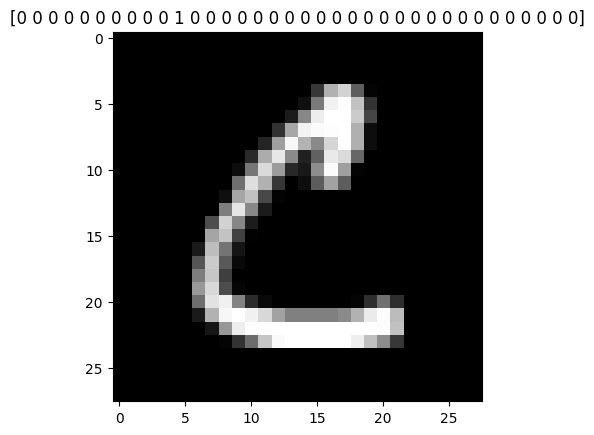

In [ ]:
# Check data with label binarizer's label
plt.imshow(data[30000].reshape(28,28), cmap='gray')
plt.title(str(labels[0]))

Penjelasan Kode : Kode tersebut bertujuan untuk menampilkan gambar dari dataset pada indeks ke-30000 (contoh angka) menggunakan Matplotlib. Selain itu, judul plot diberikan untuk menunjukkan label enkoded biner yang sesuai dengan sampel tersebut.

In [ ]:
# Since our data is not balance, we will handle it by giving weight for 'small' data

# Check number of data for each labels first
classes_total = labels.sum(axis = 0)
classes_total

array([ 6903,  7877,  6990,  7141,  6824,  6313,  6876,  7293,  6825,
        6958, 13869,  8668, 23409, 10134, 11440,  1163,  5762,  7218,
        1120,  8493,  5603, 11586, 12336, 19010, 57825, 19341,  5812,
       11566, 48419, 22495, 29008,  4182, 10784,  6272, 10859,  6076])

Penjelasan Kode : Kode tersebut bertujuan untuk menghitung jumlah sampel atau data yang terdapat dalam setiap kelas atau label setelah dilakukan enkoding one-hot pada array labels.

In [ ]:
# Check the biggest value of data
classes_total.max()

57825

Penjelasan Kode : Kode tersebut bertujuan untuk menemukan nilai maksimum dari array classes_total, yang merepresentasikan jumlah sampel atau data terbanyak di antara semua kelas atau label setelah dilakukan enkoding one-hot.

In [ ]:
# Create a weight for each data
classes_weights = {}
for i in range(0, len(classes_total)):
  #print(i)
  classes_weights[i] = classes_total.max() / classes_total[i]

# Check the weight for each data
classes_weights

{0: 8.376792698826597,
 1: 7.340992763742541,
 2: 8.272532188841202,
 3: 8.097605377398123,
 4: 8.473769050410317,
 5: 9.15967052114684,
 6: 8.409685863874346,
 7: 7.928835870012341,
 8: 8.472527472527473,
 9: 8.310577752227651,
 10: 4.169370538611291,
 11: 6.671089063221043,
 12: 2.4702037677816224,
 13: 5.7060390763765545,
 14: 5.0546328671328675,
 15: 49.72055030094583,
 16: 10.035577924331829,
 17: 8.011221945137157,
 18: 51.629464285714285,
 19: 6.808548216178029,
 20: 10.320364090665715,
 21: 4.990937338166753,
 22: 4.6875,
 23: 3.0418200946870066,
 24: 1.0,
 25: 2.989762680316426,
 26: 9.94924294562973,
 27: 4.999567698426422,
 28: 1.1942625828703608,
 29: 2.5705712380529007,
 30: 1.993415609487038,
 31: 13.827116212338593,
 32: 5.362110534124629,
 33: 9.21954719387755,
 34: 5.3250759738465785,
 35: 9.51695194206715}

Penjelasan Kode : Kode tersebut bertujuan untuk membuat bobot (weight) untuk setiap kelas atau label dalam dataset, dengan memperhatikan ketidakseimbangan dalam distribusi data.

split data to train and test

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size = 0.2, random_state = 1, stratify = labels)

Penjelasan Kode : Kode tersebut merupakan pemisahan dataset menjadi data latih dan data uji menggunakan fungsi train_test_split dari scikit-learn.

create data augmentation

In [ ]:
# Import library
from tensorflow.keras.preprocessing.image import ImageDataGenerator

Penjelasan Kode : Kode tersebut bertujuan untuk mengimpor modul ImageDataGenerator dari pustaka tensorflow.keras.preprocessing.image. Modul ini digunakan untuk melakukan augmentasi data pada gambar, yang berguna untuk meningkatkan keragaman dataset dan mencegah overfitting saat melatih model.

In [ ]:
augmentation = ImageDataGenerator(rotation_range = 10, zoom_range=0.05, width_shift_range=0.1,
                                  height_shift_range=0.1, horizontal_flip = False)

Penjelasan Kode : Kode tersebut membuat objek augmentation dari kelas ImageDataGenerator dengan menentukan beberapa parameter yang mengatur jenis augmentasi data yang akan diterapkan selama pelatihan model. Dengan mendefinisikan objek augmentation dengan parameter-parameter ini, kita dapat menggunakannya untuk menghasilkan varian gambar dari dataset selama pelatihan model, meningkatkan keragaman data dan membantu model untuk lebih baik dalam menghadapi variasi yang mungkin ada pada data baru.

build cnn model

In [ ]:
# Import library
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Flatten, Dense
from tensorflow.keras.callbacks import ModelCheckpoint

Penjelasan Kode : Kode tersebut bertujuan untuk mengimpor beberapa kelas dan modul yang akan digunakan dalam pembuatan dan pelatihan model neural network menggunakan TensorFlow dan Keras.

In [ ]:
# Build the network
network = Sequential()

network.add(Conv2D(filters = 32, kernel_size=(3,3), activation='relu', input_shape=(28,28,1)))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 64, kernel_size=(3,3), activation='relu', padding='same'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 128, kernel_size=(3,3), activation='relu', padding='valid'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Flatten())

network.add(Dense(64, activation = 'relu'))
network.add(Dense(128, activation = 'relu'))

# output
network.add(Dense(36, activation='softmax'))

network.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

Penjelasan Kode : Kode tersebut adalah implementasi dari arsitektur model neural network menggunakan library Keras dengan TensorFlow sebagai backend.

In [ ]:
# Check network summary
network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 2, 2, 128)         0

Penjelasan Kode : Kode tersebut menggunakan metode summary() untuk menampilkan ringkasan atau summary dari arsitektur model neural network yang telah dibangun.

In [ ]:
# Create actual labels
name_labels = '0123456789'
name_labels += 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
name_labels = [l for l in name_labels]

# Check actual label
print(name_labels)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


Penjelasan Kode : Kode ini digunakan untuk membuat daftar berisi label-label aktual yang kemungkinan digunakan dalam data. kode ini membuat daftar berisi 36 elemen: 10 angka (0-9) dan 26 huruf kapital (A-Z). Kemungkinan besar, daftar ini digunakan untuk memetakan label integer dari dataset Anda ke representasi string yang lebih mudah dipahami bagi manusia.

In [ ]:
import joblib

joblib.dump(name_labels, "labels.pkl")

['labels.pkl']

Penjelasan Kode : Kode tersebut digunakan untuk menyimpan daftar label name_labels ke file labels.pkl menggunakan modul joblib. Modul joblib menyediakan fungsi dump() untuk menyimpan objek Python ke file. Fungsi ini menggunakan format pickle untuk menyimpan objek, yang memungkinkannya untuk disimpan dan dimuat kembali secara efisien.
Kode tersebut akan menghasilkan file labels.pkl yang berisi daftar label name_labels. File ini dapat digunakan kembali di masa mendatang untuk memuat daftar label tanpa perlu menulis kode untuk membuat daftar tersebut lagi.

In [ ]:
a = joblib.load("labels.pkl")
print(a)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


Penjelasan Kode : Kode tersebut digunakan sebagai cara yang efisien untuk memuat daftar label yang telah disimpan sebelumnya.

train model

In [ ]:
# Set model name, epoch, and batch size
file_model = 'custom_ocr.model'
epochs = 20
batch_size = 128

Penjelasan Kode : Kode tersebut bertujuan untuk menetapkan beberapa parameter terkait pelatihan model, seperti nama file untuk menyimpan model, jumlah epochs, dan ukuran batch.

In [ ]:
# Setup checkpoint
checkpointer = ModelCheckpoint(file_model, monitor = 'val_loss', verbose = 1, save_best_only=True)

Penjelasan Kode : Kode tersebut bertujuan untuk mengonfigurasi suatu checkpoint yang akan digunakan selama pelatihan model. Checkpoint digunakan untuk menyimpan model ke dalam file setiap kali terjadi peningkatan dalam suatu metrik tertentu.

In [ ]:
# Fit the model
history = network.fit(augmentation.flow(X_train, y_train, batch_size=batch_size),
                      validation_data = (X_test, y_test),
                      steps_per_epoch = len(X_train) // batch_size, epochs=epochs,
                      class_weight = classes_weights, verbose=1, callbacks=[checkpointer])

Epoch 1/20
2765/2765 [==============================] - ETA: 0s - loss: 2.2419 - accuracy: 0.8217
Epoch 1: val_loss improved from inf to 0.30205, saving model to custom_ocr.model
2765/2765 [==============================] - 126s 44ms/step - loss: 2.2419 - accuracy: 0.8217 - val_loss: 0.3020 - val_accuracy: 0.8914
Epoch 2/20
2765/2765 [==============================] - ETA: 0s - loss: 1.0095 - accuracy: 0.8995
Epoch 2: val_loss improved from 0.30205 to 0.18060, saving model to custom_ocr.model
2765/2765 [==============================] - 123s 44ms/step - loss: 1.0095 - accuracy: 0.8995 - val_loss: 0.1806 - val_accuracy: 0.9285
Epoch 3/20
2765/2765 [==============================] - ETA: 0s - loss: 0.8147 - accuracy: 0.9137
Epoch 3: val_loss did not improve from 0.18060
2765/2765 [==============================] - 119s 43ms/step - loss: 0.8147 - accuracy: 0.9137 - val_loss: 0.2718 - val_accuracy: 0.8847
Epoch 4/20
2765/2765 [==============================] - ETA: 0s - loss: 0.7300 - accu

Penjelasan Kode : Kode tersebut bertujuan untuk menjalankan proses training model OCR Anda menggunakan data training dan validasi, augmentasi data, pengaturan epoch dan batch size, serta fungsi callback untuk menyimpan model terbaik.

evaluate model

make a single prediction

In [ ]:
# make a prediction
load_network = load_model('custom_ocr.model')
predictions = load_network.predict(X_test, batch_size=batch_size)

692/692 [==============================] - 2s 2ms/step


Penjelasan Kode : Kode tersebut berfungsi untuk melatih model neural network menggunakan data latih (X_train, y_train) dan melakukan validasi pada data uji (X_test, y_test).

In [ ]:
# Check prediction for data-0
# You will get the probability for each label
# The highest one is the prediction
predictions[10]

array([3.59907326e-09, 2.95643732e-09, 2.04848161e-09, 5.46461615e-06,
       1.10865386e-12, 1.65690237e-03, 1.05611084e-08, 2.20585616e-12,
       1.02045249e-07, 1.13867713e-07, 5.26684382e-12, 1.06409104e-09,
       1.83752569e-09, 1.08152500e-08, 2.84454751e-11, 9.80726568e-13,
       1.38416990e-05, 5.05607795e-12, 3.62108279e-15, 1.27005910e-06,
       3.33255775e-12, 1.31747291e-09, 1.50837018e-14, 1.99343320e-12,
       3.84894028e-09, 6.45263509e-10, 4.95772738e-08, 2.46224193e-16,
       9.98322308e-01, 4.39709935e-11, 2.39990276e-12, 2.81296374e-18,
       7.56019292e-12, 7.92794456e-19, 1.12046553e-11, 1.11115304e-10],
      dtype=float32)

Penjelasan Kode : Kode tersebut bertujuan untuk membuat prediksi menggunakan model neural network pada dataset uji (X_test).

In [ ]:
# Get the actual prediction -> highest probability
np.argmax(predictions[10])

28

Penjelasan Kode : Kode tersebut bertujuan untuk mendapatkan kelas yang memiliki probabilitas prediksi tertinggi untuk suatu sampel dalam dataset uji.

In [ ]:
# Check label for 24
name_labels[28]

'S'

In [ ]:
# Check y_test label for 0
y_test[10]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0])

Penjelasan Kode : Kode tersebut bertujuan untuk mengecek label aktual dari suatu sampel dalam dataset uji, khususnya untuk sampel dengan indeks 10. Ini dilakukan untuk membandingkan hasil prediksi model dengan label aktual dari data uji.

In [ ]:
# check the highest value
np.argmax(y_test[10])

28

Penjelasan Kode : Kode tersebut bertujuan untuk mengecek kelas yang memiliki nilai tertinggi dalam label aktual dari suatu sampel dalam dataset uji, khususnya untuk sampel dengan indeks 10. Ini dilakukan menggunakan fungsi np.argmax() dari NumPy.

In [ ]:
# Check the label of y_test 0
name_labels[np.argmax(y_test[10])]

'S'

Penjelasan Kode : Kode tersebut bertujuan untuk mendapatkan label aktual atau nama kelas dari suatu sampel dalam dataset uji, khususnya untuk sampel dengan indeks 10. Ini dilakukan dengan menggunakan nilai tertinggi dalam label aktual (dengan np.argmax()) untuk mendapatkan indeks kelas, dan kemudian mengambil label kelas dari list name_labels.

make an evaluate on test data

In [ ]:
# Evaluate on test data
load_network.evaluate(X_test, y_test)

2766/2766 [==============================] - 9s 3ms/step - loss: 0.1511 - accuracy: 0.9419


[0.15108269453048706, 0.9418691396713257]

Penjelasan Kode : Kode tersebut bertujuan untuk mengevaluasi performa model neural network pada data uji (X_test, y_test). Metode evaluate pada objek model digunakan untuk mengukur nilai loss dan metrik lainnya (seperti akurasi) pada data uji.

In [ ]:
# Print Classification Report
print(classification_report(y_test.argmax(axis=1), predictions.argmax(axis=1), target_names = name_labels))

              precision    recall  f1-score   support

           0       0.29      0.80      0.43      1381
           1       0.97      0.99      0.98      1575
           2       0.89      0.97      0.93      1398
           3       0.96      0.99      0.97      1428
           4       0.93      0.97      0.95      1365
           5       0.71      0.94      0.81      1263
           6       0.96      0.98      0.97      1375
           7       0.95      0.99      0.97      1459
           8       0.93      0.99      0.96      1365
           9       0.96      0.98      0.97      1392
           A       0.99      0.99      0.99      2774
           B       0.98      0.99      0.98      1734
           C       0.99      0.98      0.99      4682
           D       0.93      0.97      0.95      2027
           E       1.00      0.99      0.99      2288
           F       0.95      1.00      0.98       233
           G       0.95      0.95      0.95      1152
           H       0.98    

Penjelasan Kode : Kode tersebut menggunakan fungsi classification_report dari modul sklearn.metrics untuk mencetak laporan klasifikasi yang menyediakan sejumlah metrik evaluasi pada model klasifikasi.

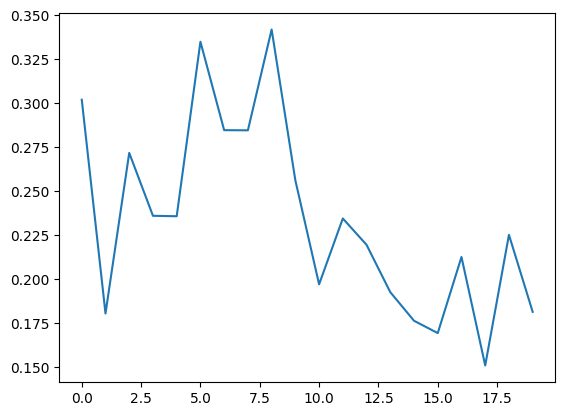

In [ ]:
# Visualize loss value for each epoch
plt.plot(history.history['val_loss'])

Penjelasan Kode : Kode tersebut digunakan untuk memvisualisasikan nilai loss validasi model Anda selama proses training.

In [ ]:
# You can also check the another metrics
history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

Penjelasan Kode : Kode tersebut menggunakan atribut history yang dihasilkan dari proses pelatihan model untuk mendapatkan kunci atau nama metrik yang tersedia.

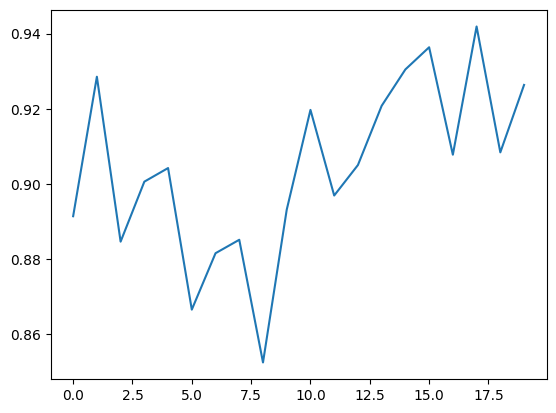

In [ ]:
# Check the model performance by validation accuracy
plt.plot(history.history['val_accuracy'])

Penjelasan Kode : Kode tersebut digunakan untuk memvisualisasikan akurasi validasi model Anda selama proses training.

save the model

In [ ]:
# The result will show in colab directory
network.save('model_cnn_ml', save_format= 'h5')

save_path="/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset"
network.save(save_path)

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Penjelasan Kode : Kode tersebut digunakan untuk menyimpan model OCR yang telah terlatih ke Google Colab.

### Testing Dataset

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import imutils
import cv2
from tensorflow.keras.models import load_model
from imutils.contours import sort_contours
from google.colab.patches import cv2_imshow
import glob
import os

Penjelasan Kode : Kode from tensorflow.keras.models import load_model digunakan untuk mengimpor modul load_model dari library tensorflow.keras. Modul ini menyediakan fungsi load_model yang digunakan untuk memuat model yang telah disimpan sebelumnya.

In [ ]:
# Load saved network
network = load_model('/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset')

Penjelasan Kode : Kode network: Ini adalah variabel yang akan menyimpan model yang dimuat. Kode load_model: Ini adalah fungsi dari library tensorflow.keras yang digunakan untuk memuat model yang telah disimpan sebelumnya. Kode 'network': Ini adalah nama file yang berisi model yang akan dimuat.

In [ ]:
# Check summary
network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 2, 2, 128)         0

Penjelasan Kode : Kode tersebut digunakan untuk menampilkan ringkasan (summary) dari arsitektur model neural network.

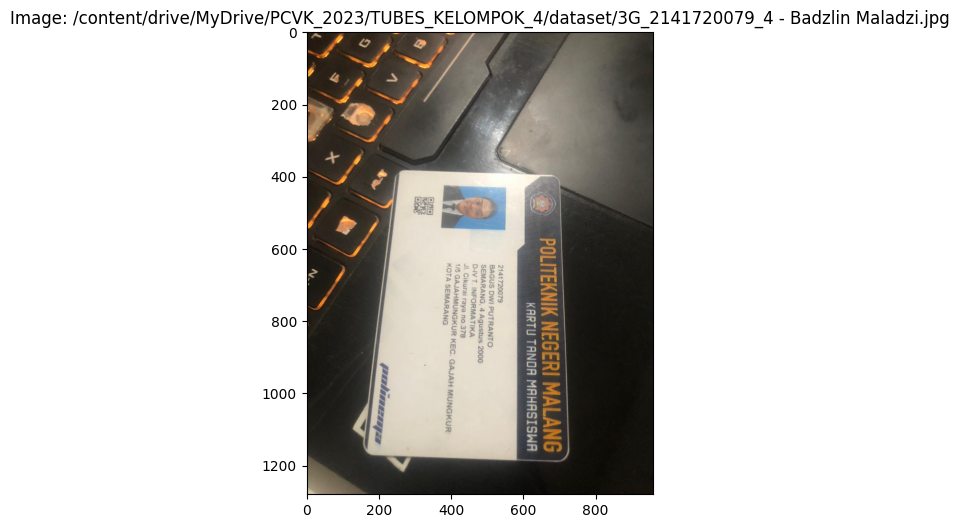

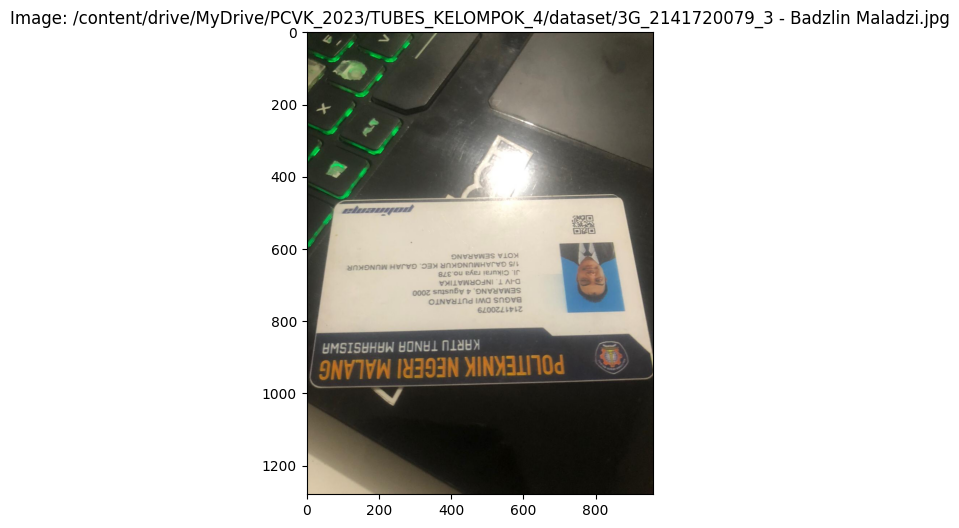

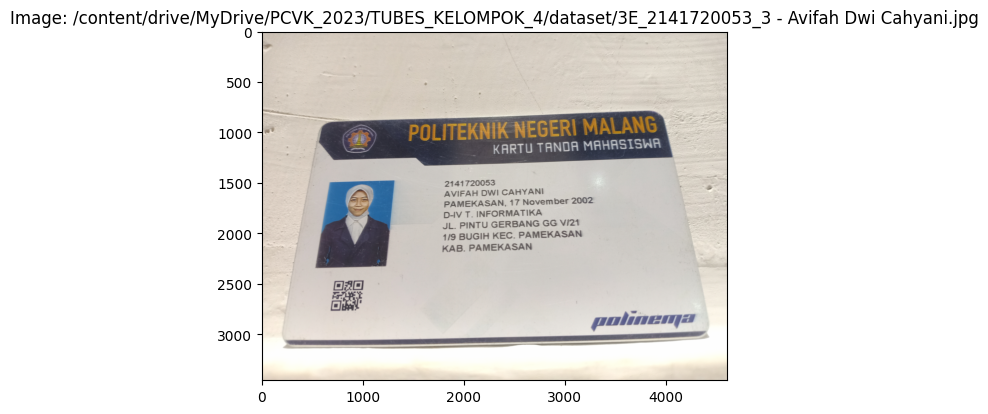

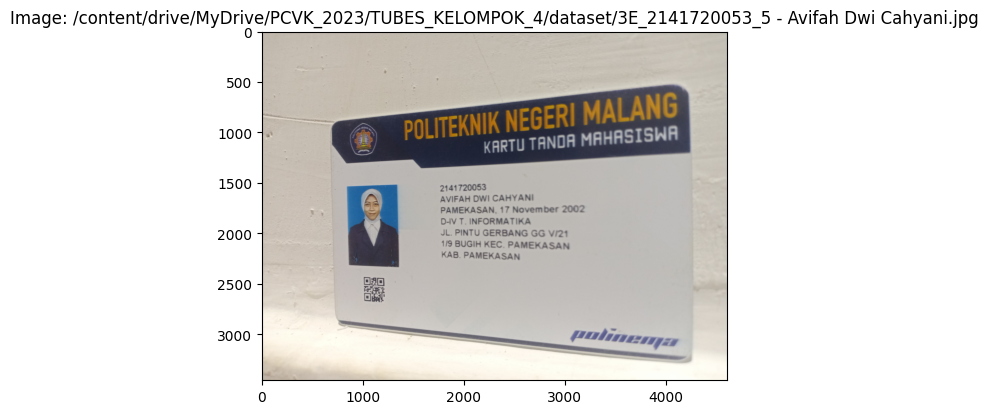

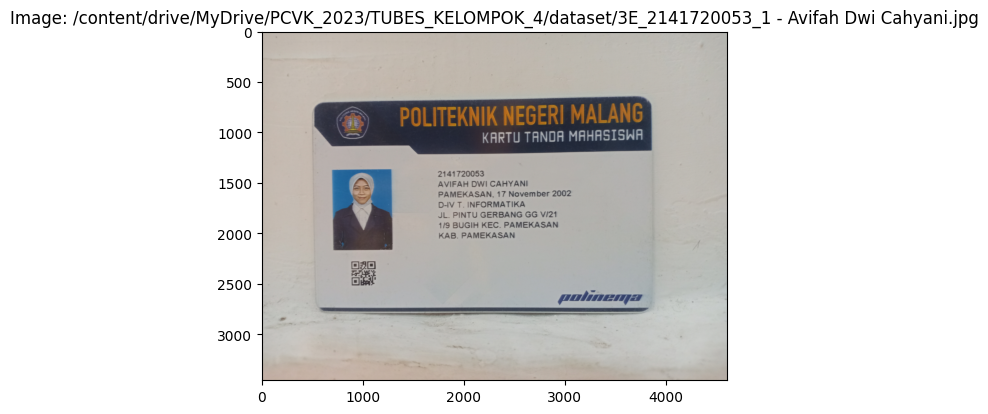

...

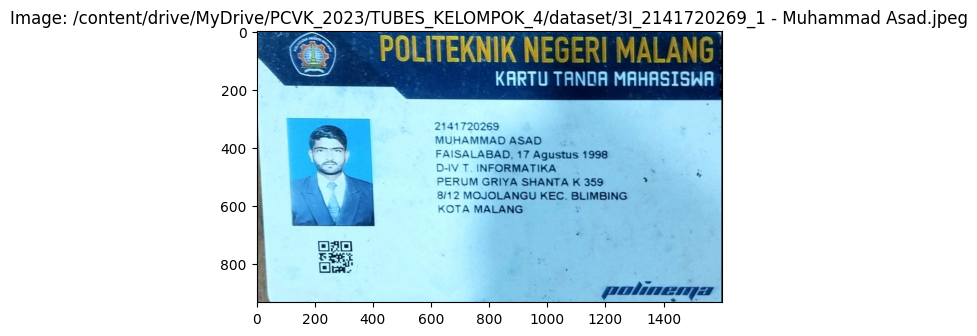

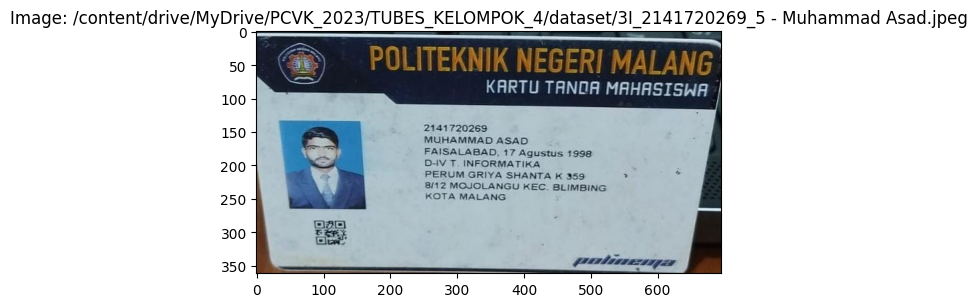

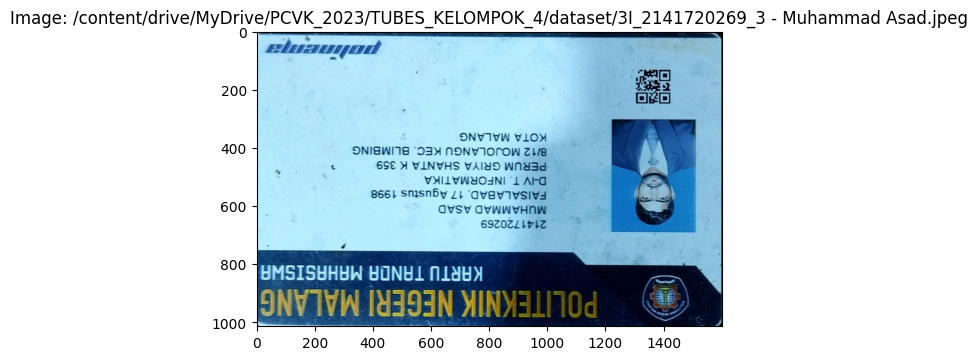

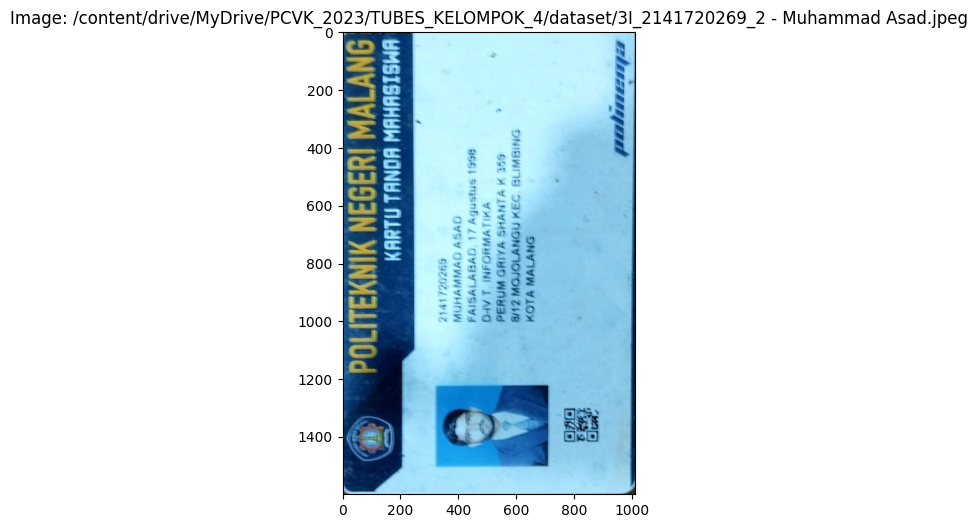

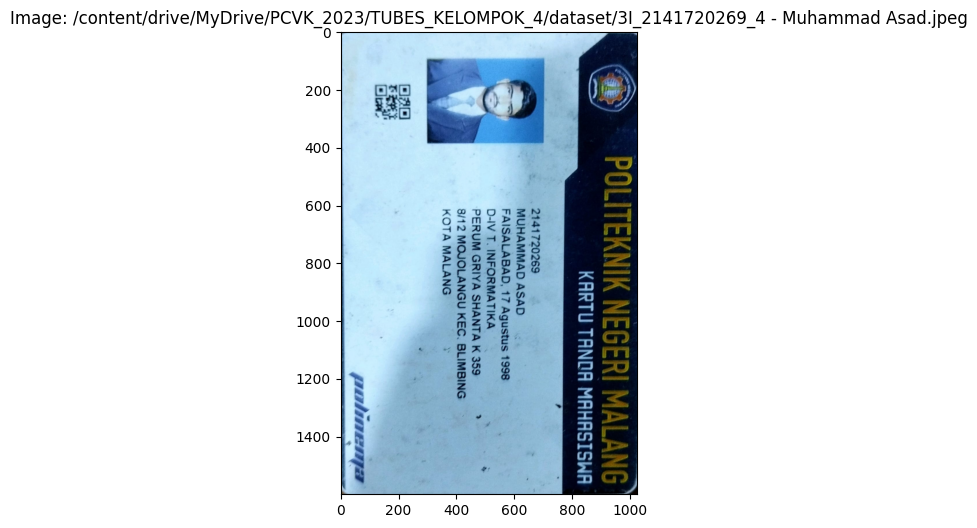

In [ ]:
# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpeg
image_files = glob.glob(image_folder_path + '*.jpg')+ glob.glob(image_folder_path + '*.jpeg')

# Loop melalui setiap file gambar dan menampilkannya
for image_path in image_files:
    # Baca gambar menggunakan OpenCV
    original_image = cv2.imread(image_path)

    # Periksa apakah pembacaan gambar berhasil
    if original_image is None:
        print(f"Gambar {image_path} tidak dapat dibaca.")
    else:
        # Tampilkan gambar menggunakan matplotlib
        fig, ax = plt.subplots(figsize=(6, 6))
        ax.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
        ax.set_title(f"Image: {image_path}")
        plt.show()

Penjelasan Kode :
Kode tersebut digunakan untuk membaca dan menampilkan gambar-gambar yang terdapat dalam sebuah direktori. Kode ini menggunakan dua pustaka Python, yaitu glob untuk mendapatkan daftar file gambar dan cv2 untuk membaca dan menampilkan gambar. Fungsi glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg sedangkan cv2 untuk membaca gambar.

#### Function Dataset (Pre-processing)

Function image 1 (Asad 1)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 2 (Asad 2)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_2(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 3 (Asad 3)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_3(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 4 (Asad 4)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_4(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 5 (Asad 5)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_5(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 6 (Avifah 1)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_6(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 7 (Avifah 2)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_7(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 8 (Avifah 3)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_8(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 9 (Avifah 4)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_9(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 10 (Avifah 5)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_10(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 700, 800, 3150, 1950

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 11 (Badzlin 1)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_11(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 10, 300, 1000, 1000

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 12 (Badzlin 2)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_12(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 10, 200, 1000, 1000

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 13 (Badzlin 3)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_13(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 10, 200, 1000, 1000

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 14 (Badzlin 4)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_14(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 10, 200, 1000, 1000

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

Function image 15 (Badzlin 5)

In [ ]:
def global_thresholding(image, threshold):
    binary = np.zeros_like(image)
    binary[image > threshold] = 255
    return binary
def cutting(image, x, y, width, height):
    # Crop the region of interest from the image
    hasil = image[y:y+height, x:x+width]
    return hasil

#invertion =
# Erode
#erode = cv2.erode(invertion, np.ones((1,1)))
def preprocess_image_15(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')

    # Tentukan koordinat untuk crop
    # x, y, width, height = 10, 200, 1000, 1000

    # img = cutting(img, x, y, width, height)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('on')

    # Gaussian Blur untuk menghilangkan noise
    blurred_img = cv2.GaussianBlur(gray, (5, 5), 1)
    plt.subplot(2, 3, 3)
    plt.imshow(blurred_img, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('on')

    # Apply Global Threshold
    global_threshold = global_thresholding(blurred_img, 150)
    plt.subplot(2, 3, 4)
    plt.imshow(global_threshold, cmap='gray')
    plt.title('Global Threshold')
    plt.axis('on')

    #Erosi the image
    erode_ktm = cv2.erode(global_threshold.copy(), cv2.getStructuringElement(cv2.MORPH_OPEN, (1, 2)))
    plt.subplot(2, 3, 5)
    plt.imshow(erode_ktm, cmap='gray')
    plt.title('Erosi Image')
    plt.axis('on')

    # Invert the image
    invertion = 255 - erode_ktm
    plt.subplot(2, 3, 6)
    plt.imshow(invertion, cmap='gray')
    plt.title('Invertion Image')
    plt.axis('on')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, invertion

#### Function OCR

In [ ]:
def process_contours(conts, invertion, img, min_w, max_w, min_h, max_h):
    img_copy = img.copy()

    for c in conts:
        (x, y, w, h) = cv2.boundingRect(c)

        if min_w <= w <= max_w and min_h <= h <= max_h:
            roi = invertion[y:y+h, x:x+w]
            # thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
            cv2_imshow(roi)  # Check

            cv2.rectangle(img_copy, (x, y), (x+w, y+h), (255, 0, 0), 2)

    # Show bounding box on original image
    cv2_imshow(img_copy)

In [ ]:
def extract_roi(img, x, y, w, h, margin=2):
    roi = img[y - margin:y+h, x - margin:x + w + margin]
    return roi

In [ ]:
def resize_img(img, w, h):
    if w > h:
        resized = imutils.resize(img, width=28)
    else:
        resized = imutils.resize(img, height=28)

    print("Resized Image Shape:", resized.shape)  # Add this line

    # (w, h) = resized.shape
    (h, w) = resized.shape

    # Calculate how many pixels need to fill char image
    dX = int(max(0, 28 - w) / 2.0)
    dY = int(max(0, 28 - h) / 2.0)

    filled = cv2.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv2.BORDER_CONSTANT, value=(0, 0, 0))

    print("Filled Image Shape:", filled.shape)  # Add this line

    filled = cv2.resize(filled, (28, 28))

    return filled


In [ ]:
def normalization(img):
  img = img.astype('float32') / 255.0 # convert to floating point
  img = np.expand_dims(img, axis=-1) # add depth
  return img

In [ ]:
def process_box(img, x, y, w, h):
  roi = extract_roi(img, x, y, w, h)
  # thresh = thresholding(roi)
  (h, w) = roi.shape
  resized = resize_img(roi, w, h)

  cv2_imshow(resized)  # Show result

  normalized = normalization(resized)

  return (normalized, (x, y, w, h))

In [ ]:
def detect_characters(conts, gray, min_w, max_w, min_h, max_h):
    detected_char = []
    for c in conts:
        (x, y, w, h) = cv2.boundingRect(c)

        if min_w <= w <= max_w and min_h <= h <= max_h:
            detected_char.append(process_box(gray, x, y, w, h))

    return detected_char

In [ ]:
def find_contours(img):
  conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  conts = imutils.grab_contours(conts)
  conts = sort_contours(conts, method='left-to-right')[0]

  return conts

#### Function OCR Dataset

OCR_Asad_1

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Asad_2

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_2(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Asad_3

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_3(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Asad_4

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_4(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Asad_5

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_5(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Avifah_1

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_6(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Avifah_2

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_7(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Avifah_3

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_8(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Avifah_4

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_9(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Avifah_5

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_10(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Badzlin_1

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_11(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Badzlin_2

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_12(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Badzlin_3

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_13(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Badzlin_4

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_14(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

OCR_Badzlin_5

In [ ]:
def ocr(image_path):
    img, gray, invertion = preprocess_image_15(image_path)

    min_w, max_w = 10, 160
    min_h, max_h = 25, 140

    conts = find_contours(invertion.copy())
    process_contours(conts, invertion, img, min_w, max_w, min_h, max_h)

    detected_char = detect_characters(conts, invertion, min_w, max_w, min_h, max_h)

    pixels = np.array([px[0] for px in detected_char], dtype='float32')
    boxes = [box[1] for box in detected_char]

    digits = '0123456789'
    letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
    char_list = digits + letters
    char_list = [ch for ch in char_list]

    print(char_list)

    # Predict
    preds = network.predict(pixels)

    # check shape -> JTI POLINEMA --> shoud be 11 (from 0 to 10)
    preds.shape

    # Char Prediction
    for p in preds:
      char_idx = np.argmax(p)
      print(char_list[char_idx], end = " ")

    # Show char with actual image
    img_copy2 = img.copy()

    for(pred, (x, y, w, h)) in zip(preds, boxes):
      i = np.argmax(pred)
      char_detected = char_list[i]

      cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (0,255,0), 2)
      cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 2)

    cv2_imshow(img_copy2)

#### Hasil OCR Dataset

Asad 1

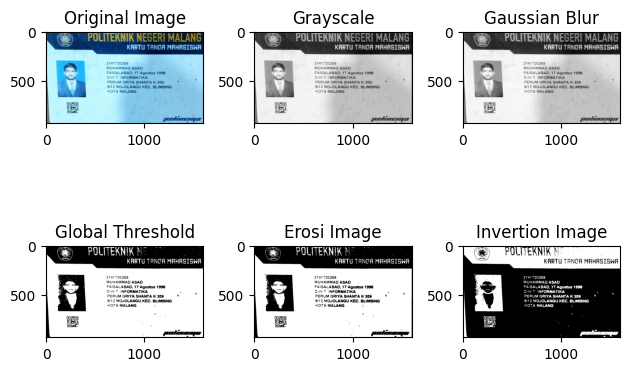

In [ ]:
image_path = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3I_2141720269_1 - Muhammad Asad.jpeg'
Preprocess = preprocess_image(image_path)

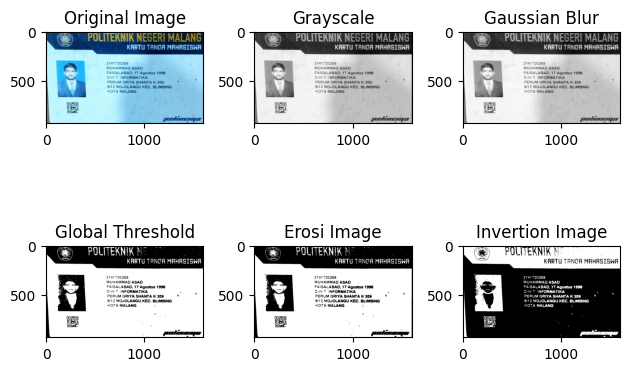

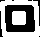

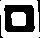

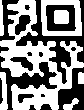

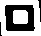

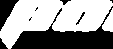

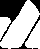

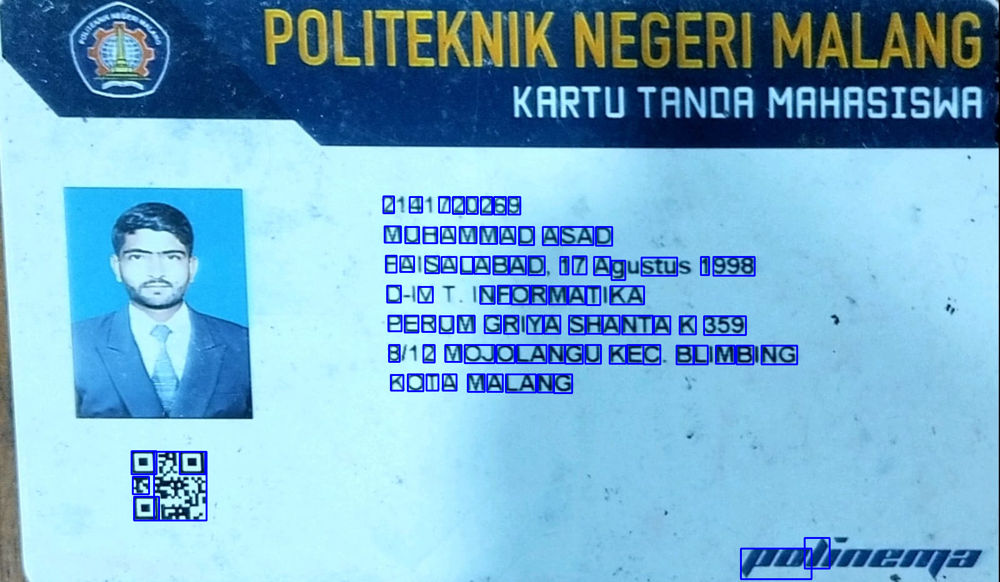

Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (16, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (16, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (16, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 15)
Filled Image Shape: (28, 27)


Resized Image Shape: (15, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (16, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 15)
Filled Image Shape: (28, 27)


Resized Image Shape: (12, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (12, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (12, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']
3/3 [==============================] - 2s 95ms/step
B R B B B 2 M F D D 8 K A E U 0 2 V R 2 H S T 7 U A A B N 2 N M L U Q M A N N 2 G B B G 0 F A R U 9 A 0 U D V 0 R N A B N M G 4 M G A S 7 U H T B 0 B K M Q M E M C A B K L 9 M M M B M M D 

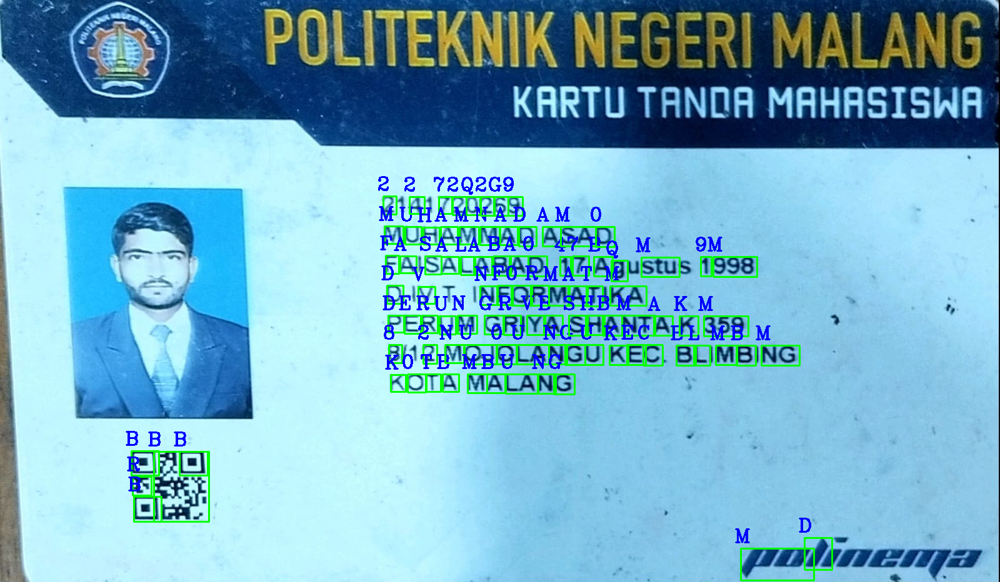

In [ ]:
ocr(image_path)

Asad 2

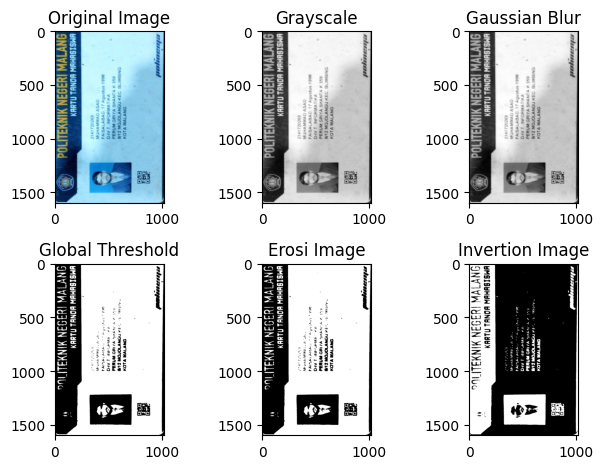

In [ ]:
image_path_2 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3I_2141720269_2 - Muhammad Asad.jpeg'
Preprocess = preprocess_image_2(image_path_2)

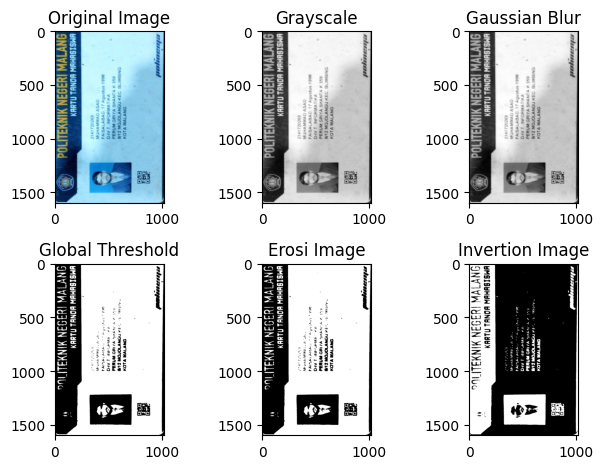

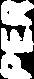

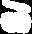

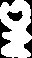

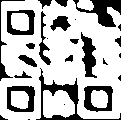

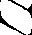

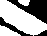

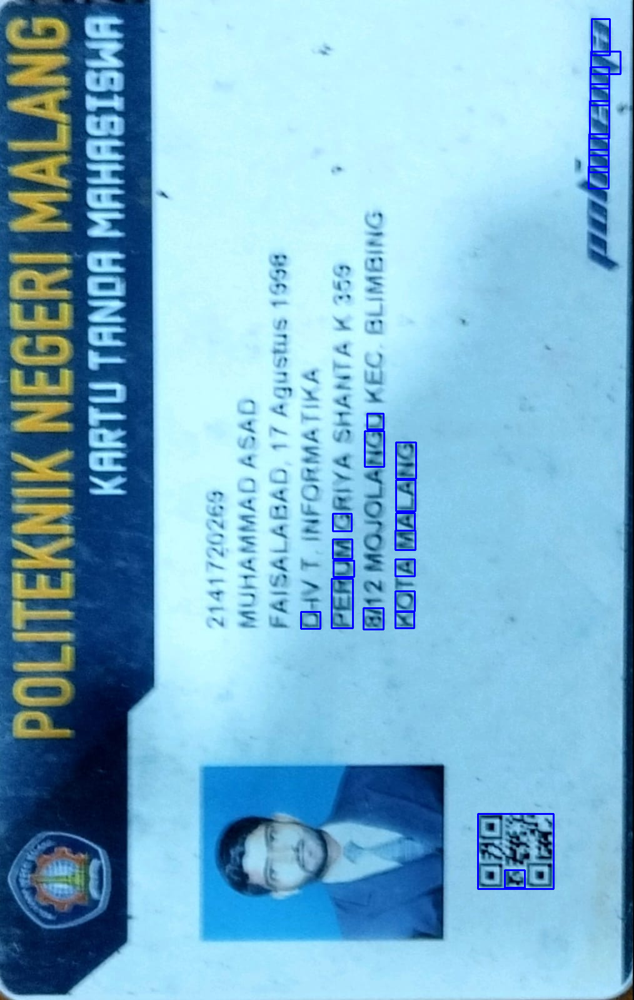

Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 13)
Filled Image Shape: (28, 27)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (21, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 18)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 15)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (20, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 15)
Filled Image Shape: (28, 27)


['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']
1/1 [==============================] - 0s 222ms/step
Q 8 8 0 2 Z 8 J Z 0 O S Q S 3 B R S F R S K S S Q 

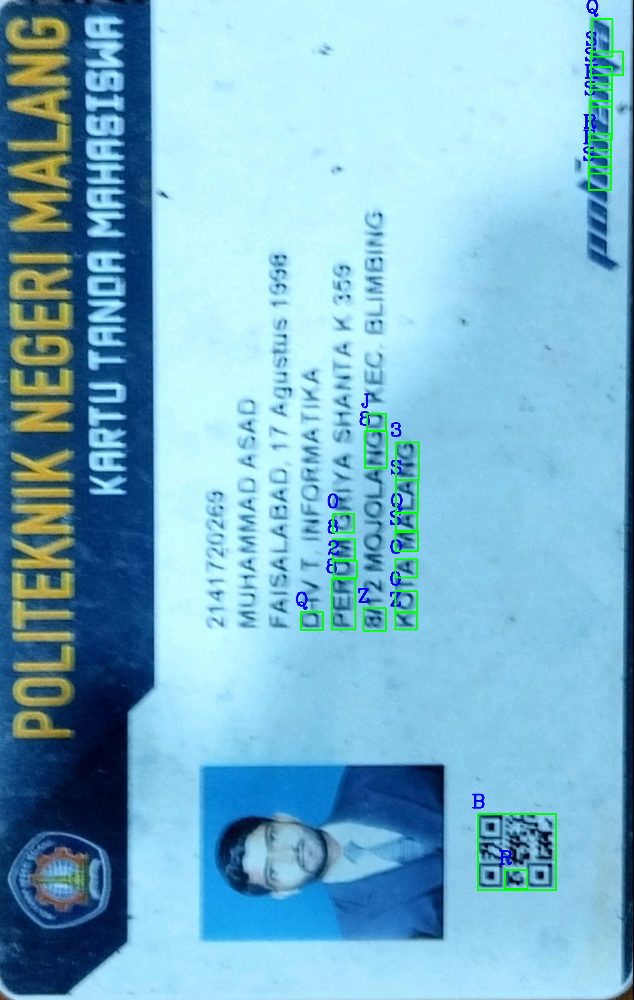

In [ ]:
ocr(image_path_2)

Asad 3

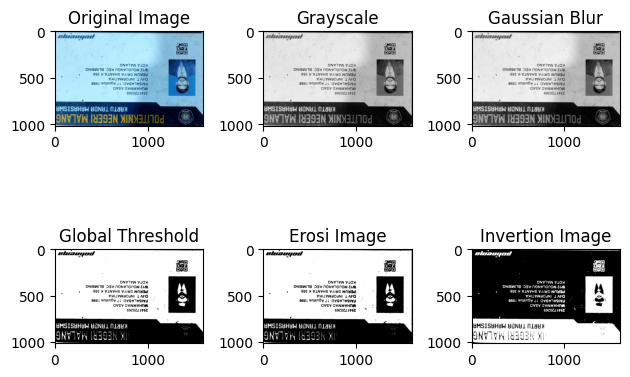

In [ ]:
image_path_3 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3I_2141720269_3 - Muhammad Asad.jpeg'
Preprocess = preprocess_image_3(image_path_3)

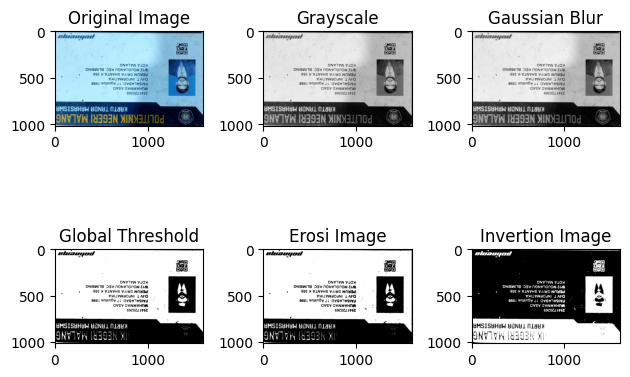

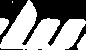

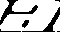

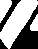

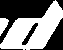

...

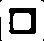

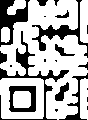

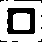

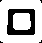

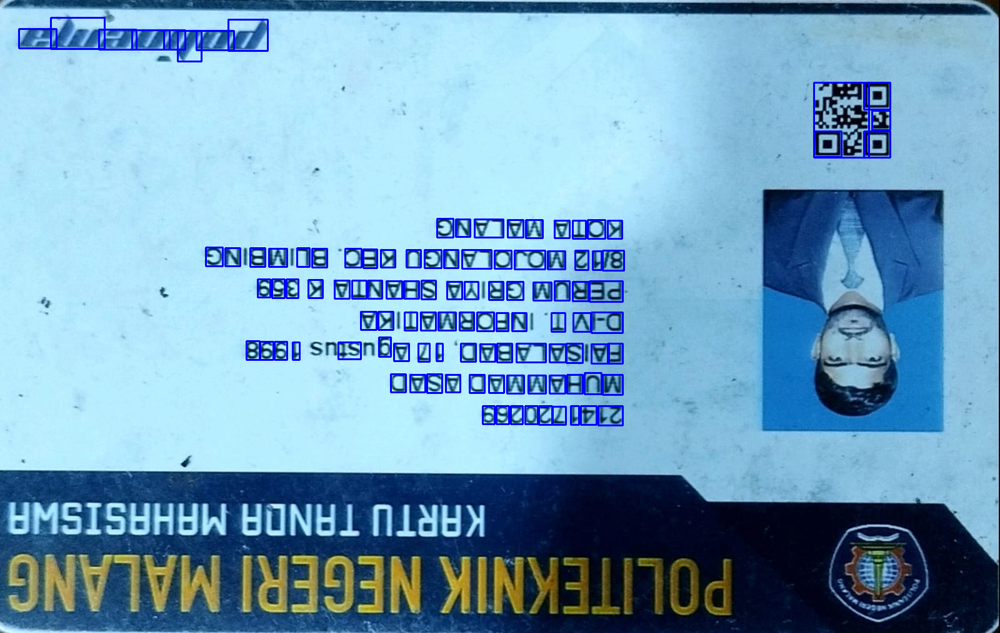

Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (16, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (14, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (21, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 14)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (20, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 19)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 19)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 13)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (17, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (17, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 20)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (16, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (17, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 26)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 14)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 22)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (17, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (18, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 15)
Filled Image Shape: (28, 27)


Resized Image Shape: (21, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 24)
Filled Image Shape: (28, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 21)
Filled Image Shape: (28, 27)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']
4/4 [==============================] - 0s 132ms/step
R M M M R R M 2 N U 8 8 G 6 W S G E L 7 Z Q V B 2 1 H 3 N Z 5 Z V O H H L A H L H S 2 S L 2 W N H V N Y O D 1 O M 0 H 5 V Y 0 9 J Q W S H Z N 0 D 0 W W W Z W W W 1 L 7 V S H L Y L N Z B N 0 W W M L U U R Y Z E B G B 8 

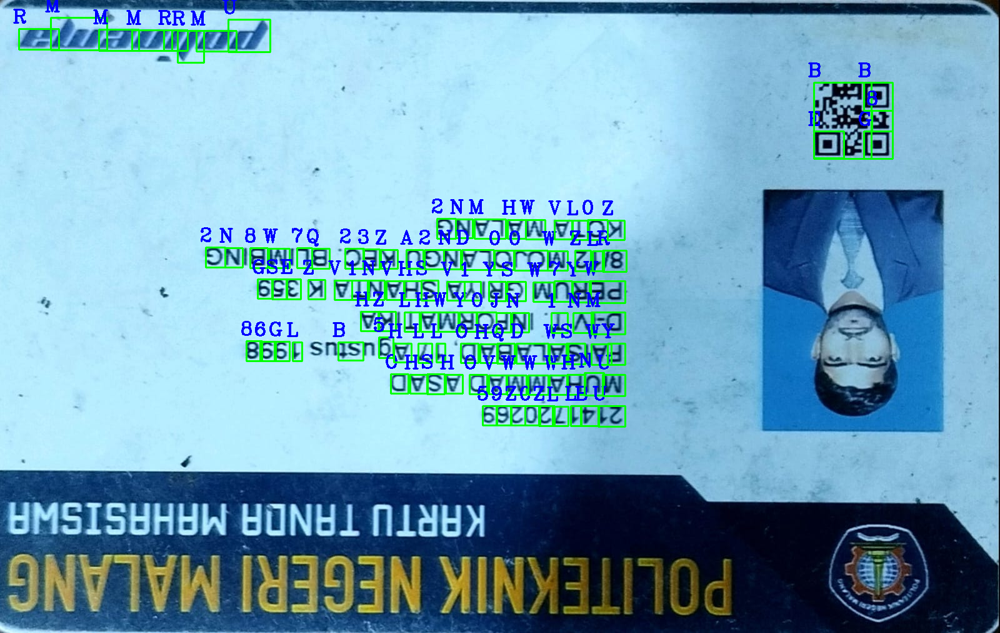

In [ ]:
ocr(image_path_3)

Asad 4

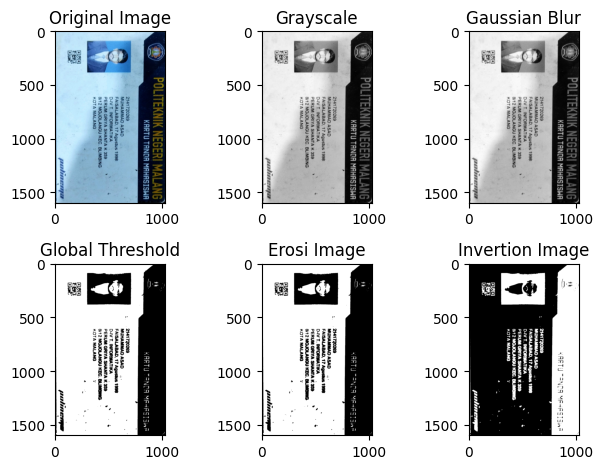

In [ ]:
image_path_4 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3I_2141720269_4 - Muhammad Asad.jpeg'
Preprocess = preprocess_image_4(image_path_4)

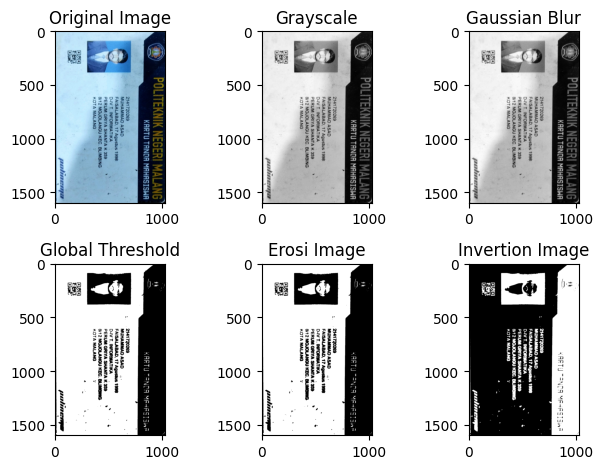

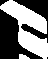

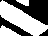

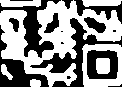

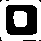

...

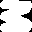

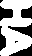

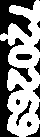

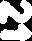

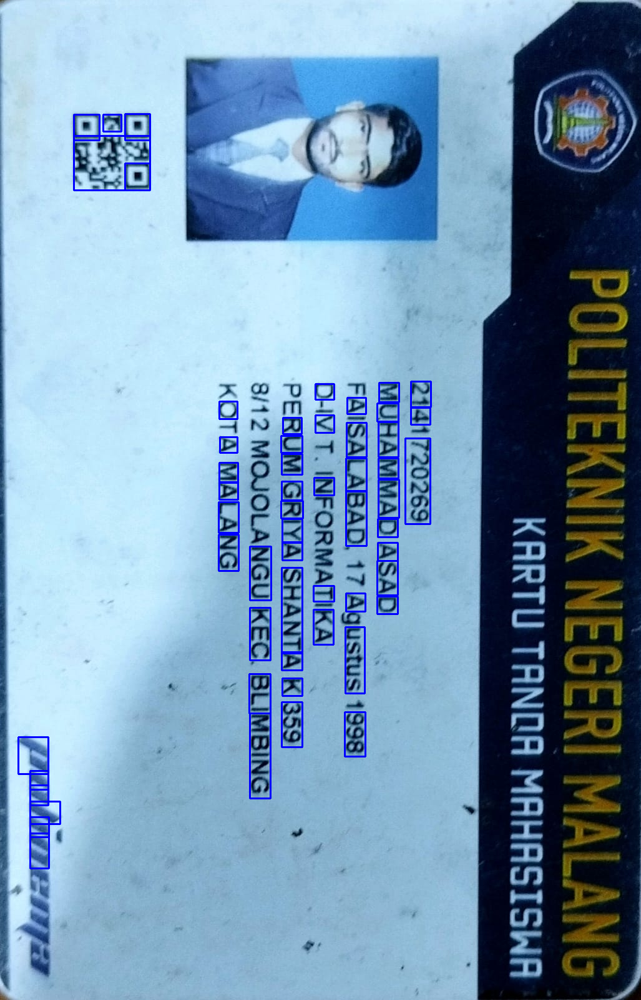

Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (20, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (19, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 19)
Filled Image Shape: (28, 27)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (27, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 7)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 12)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 12)
Filled Image Shape: (28, 28)


Resized Image Shape: (21, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (21, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 14)
Filled Image Shape: (28, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 7)
Filled Image Shape: (28, 27)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 25)
Filled Image Shape: (28, 27)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 17)
Filled Image Shape: (28, 27)


Resized Image Shape: (20, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (22, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 14)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 9)
Filled Image Shape: (28, 27)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 11)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 19)
Filled Image Shape: (28, 27)


Resized Image Shape: (28, 17)
Filled Image Shape: (28, 27)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (22, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 18)
Filled Image Shape: (28, 28)


Resized Image Shape: (22, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (24, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


Resized Image Shape: (26, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 17)
Filled Image Shape: (28, 27)


Resized Image Shape: (25, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 8)
Filled Image Shape: (28, 28)


Resized Image Shape: (23, 28)
Filled Image Shape: (27, 28)


Resized Image Shape: (28, 23)
Filled Image Shape: (28, 27)


['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']
2/2 [==============================] - 0s 201ms/step
J S U 5 U R M G 7 G B 8 5 D B 0 D R 1 8 8 J C 8 Z 3 Q Z Z B 2 J S 4 Z C 0 8 8 D E 5 B D 0 8 E D 0 8 8 5 Z 3 D H 

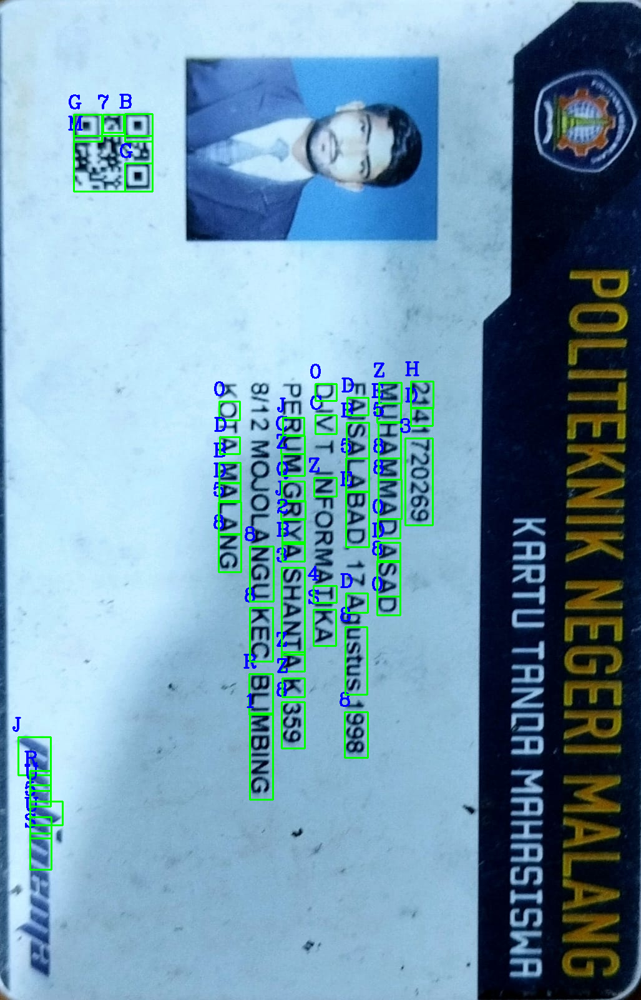

In [ ]:
ocr(image_path_4)

Asad 5

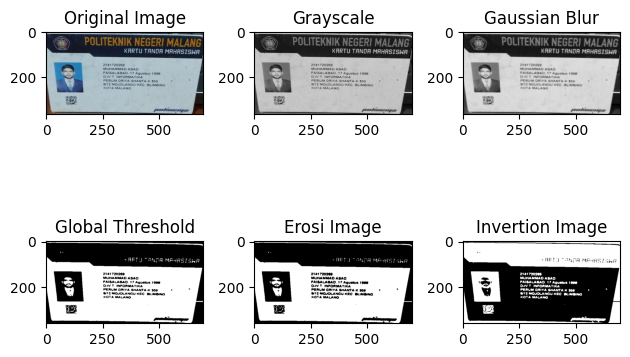

In [ ]:
image_path_5 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3I_2141720269_5 - Muhammad Asad.jpeg'
Preprocess = preprocess_image_5(image_path_5)

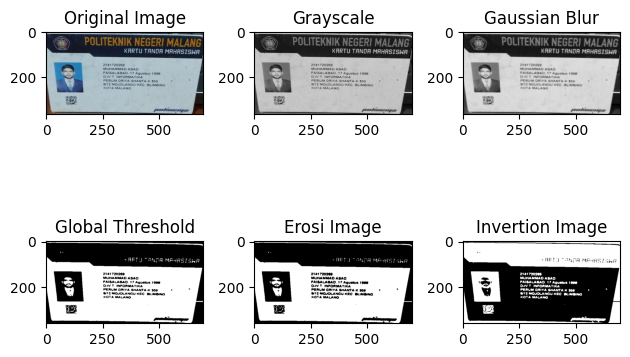

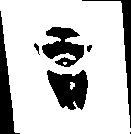

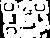

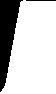

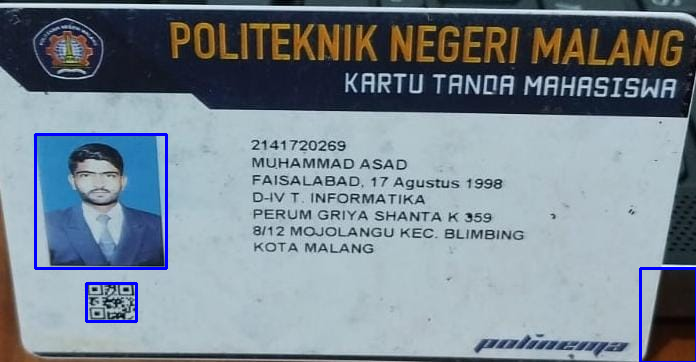

Resized Image Shape: (28, 27)
Filled Image Shape: (28, 27)


Resized Image Shape: (20, 28)
Filled Image Shape: (28, 28)


Resized Image Shape: (28, 16)
Filled Image Shape: (28, 28)


['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']
1/1 [==============================] - 0s 194ms/step
B R A 

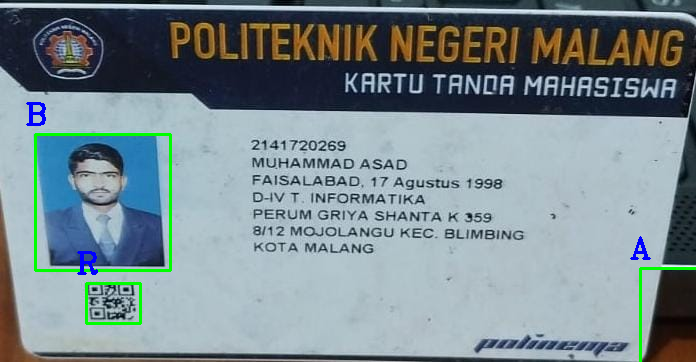

In [ ]:
ocr(image_path_5)

Avifah 1

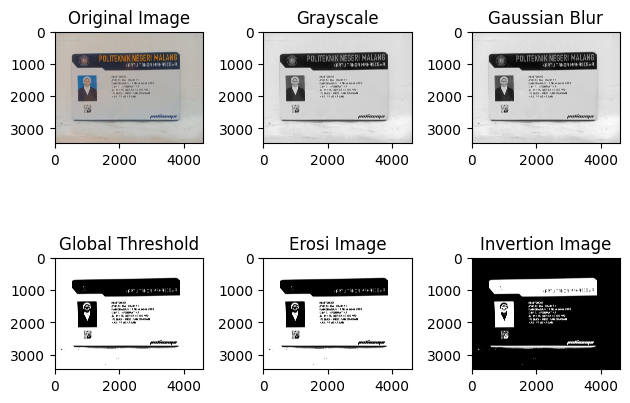

In [ ]:
image_path_6 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3E_2141720053_1 - Avifah Dwi Cahyani.jpg'
Preprocess = preprocess_image_6(image_path_6)

In [ ]:
ocr(image_path_6)

Avifah 2

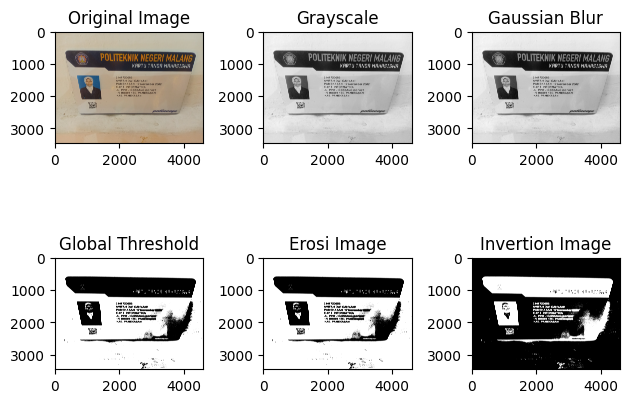

In [ ]:
image_path_7 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3E_2141720053_2 - Avifah Dwi Cahyani.jpg'
Preprocess = preprocess_image_7(image_path_7)

In [ ]:
ocr(image_path_7)

Avifah 3

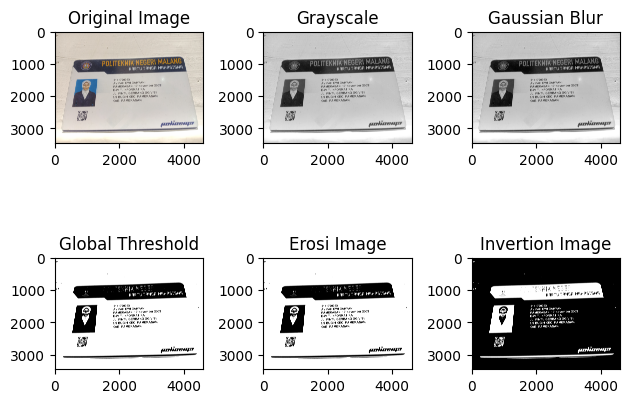

In [ ]:
image_path_8 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3E_2141720053_3 - Avifah Dwi Cahyani.jpg'
Preprocess = preprocess_image_8(image_path_8)

In [ ]:
ocr(image_path_8)

Avifah 4

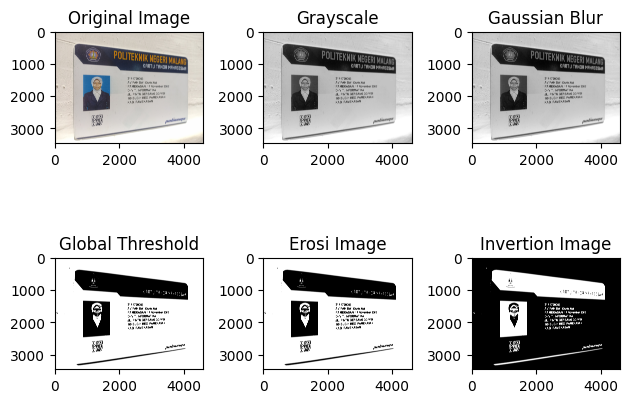

In [ ]:
image_path_9 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3E_2141720053_4 - Avifah Dwi Cahyani.jpg'
Preprocess = preprocess_image_9(image_path_9)

In [ ]:
ocr(image_path_9)

Avifah 5

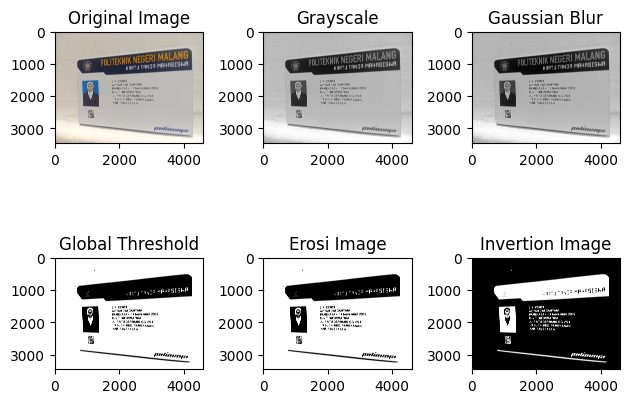

In [ ]:
image_path_10 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3E_2141720053_5 - Avifah Dwi Cahyani.jpg'
Preprocess = preprocess_image_10(image_path_10)

In [ ]:
ocr(image_path_10)

Badzlin 1

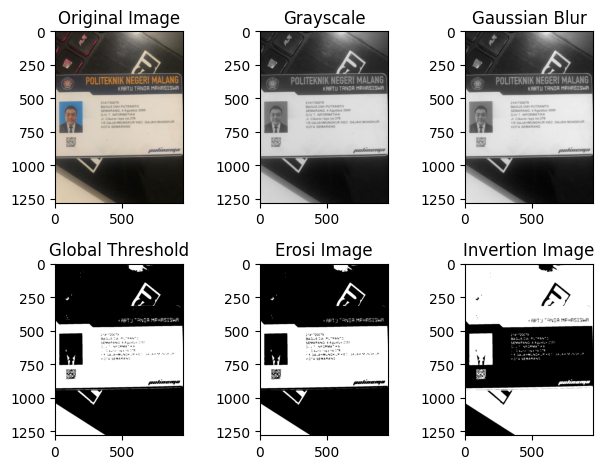

In [ ]:
image_path_11 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3G_2141720079_1 - Badzlin Maladzi.jpg'
Preprocess = preprocess_image_11(image_path_11)

In [ ]:
ocr(image_path_11)

Badzlin 2

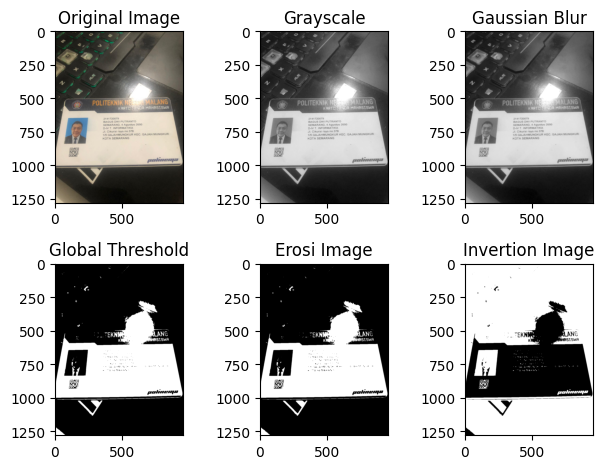

In [ ]:
image_path_12 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3G_2141720079_2 - Badzlin Maladzi.jpg'
Preprocess = preprocess_image_12(image_path_12)

In [ ]:
ocr(image_path_12)

Badzlin 3

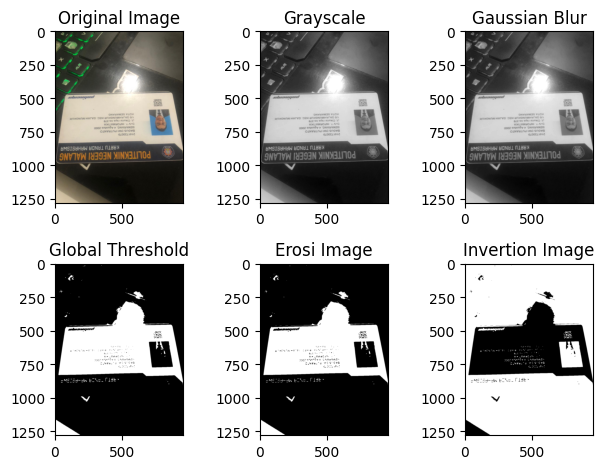

In [ ]:
image_path_13 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3G_2141720079_3 - Badzlin Maladzi.jpg'
Preprocess = preprocess_image_13(image_path_13)

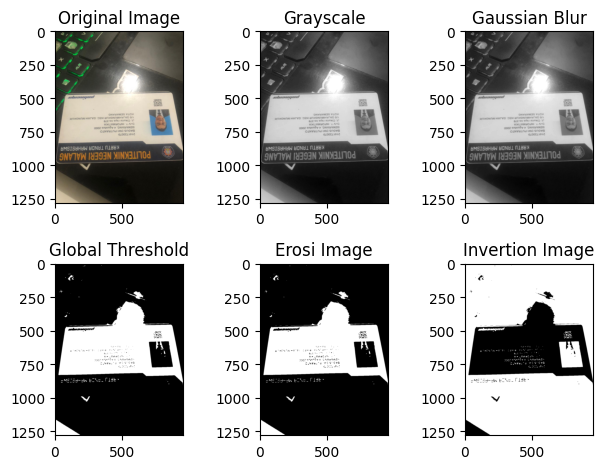

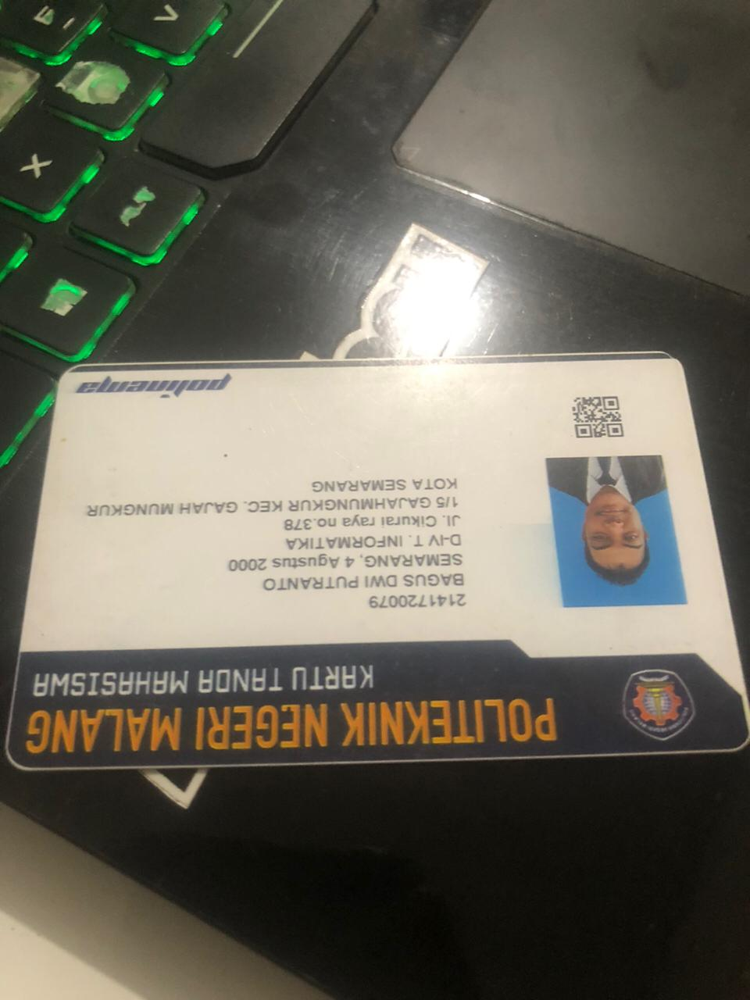

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


ValueError: ignored

In [ ]:
ocr(image_path_13)

Badzlin 4

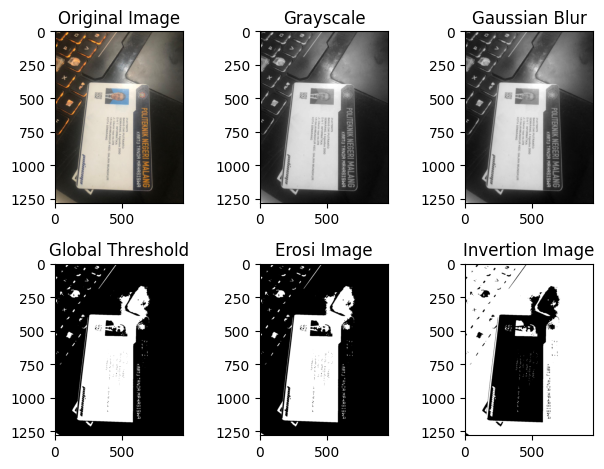

In [ ]:
image_path_14 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3G_2141720079_4 - Badzlin Maladzi.jpg'
Preprocess = preprocess_image_14(image_path_14)

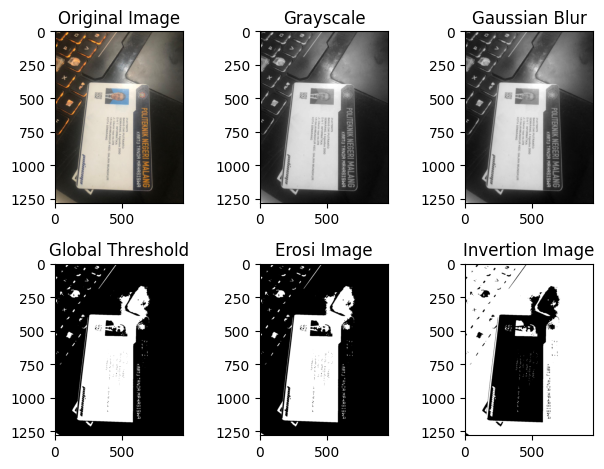

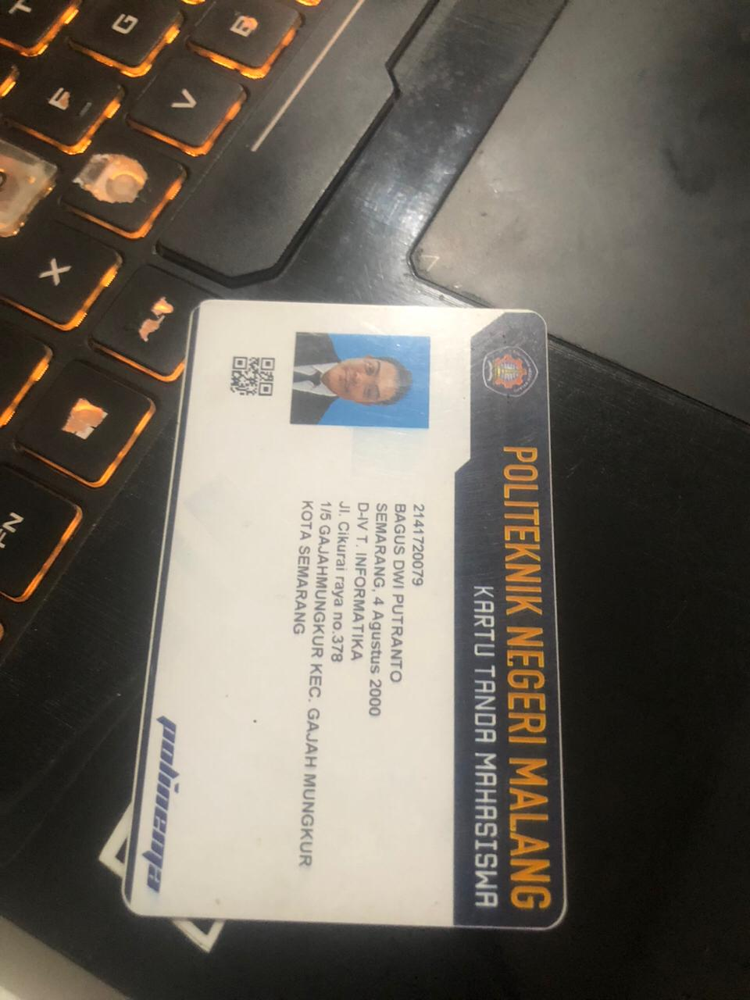

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


ValueError: ignored

In [ ]:
ocr(image_path_14)

Badzlin 5

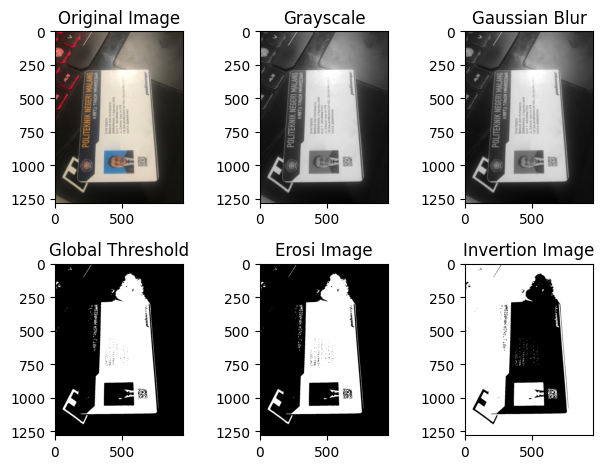

In [ ]:
image_path_15 = '/content/drive/MyDrive/PCVK_2023/TUBES_KELOMPOK_4/dataset/3G_2141720079_5 - Badzlin Maladzi.jpg'
Preprocess = preprocess_image_15(image_path_15)

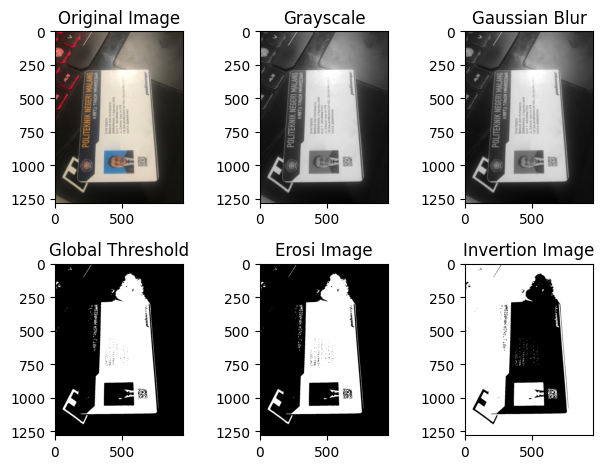

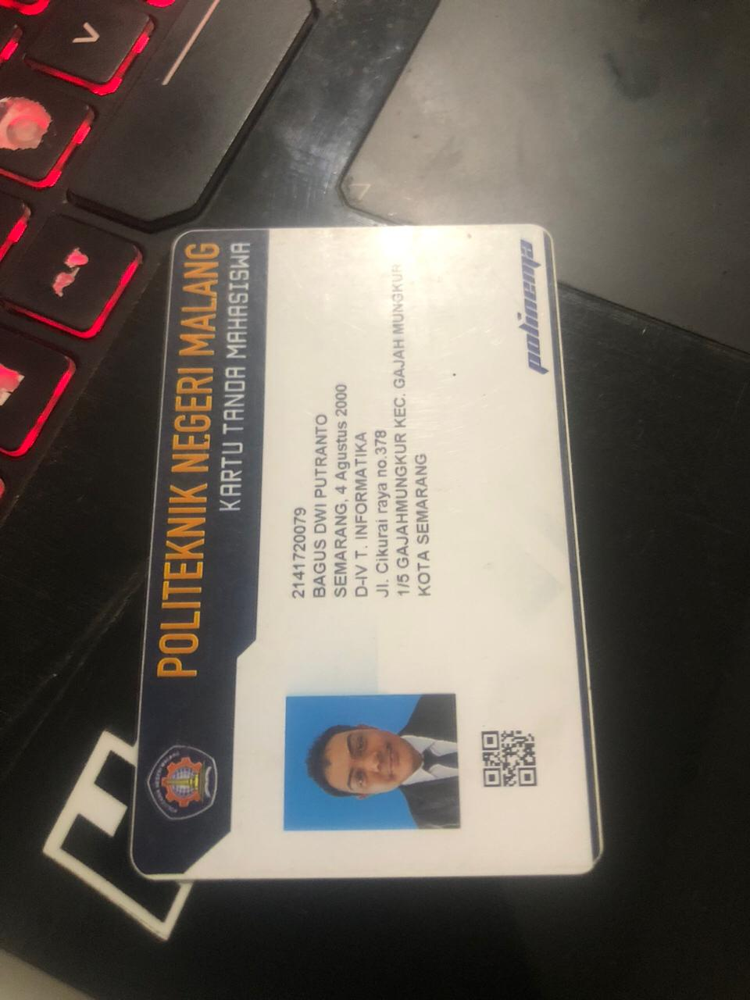

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


ValueError: ignored

In [ ]:
ocr(image_path_15)